In [1]:
library(broom)
library(tidyverse)
library(dplyr)
library(tidymodels)
library(ranger)
library(readr)       
library(janitor)
library(scales)
library(ggplot2)
library(vip)
library(dplyr)

── Attaching core tidyverse packages ──────────────────────────────────────────────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.2     ✔ tibble    3.2.1
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.0.4     
── Conflicts ────────────────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────────────────────────────────────────────── tidymodels 1.3.0 ──

✔ dials        1.4.0     ✔ rsample      1.3.0
✔ infer        1.0.8     ✔ tune         1.3.0
✔ modeldata    1.4.0     ✔ workflows    1.2.0
✔ parsnip      1.3.1     ✔ workflowsets 1.1.0
✔ recipes      1.2.1     ✔ yardstick    1.3.2

── Conflicts ──────────────────────────────

In [2]:
dataset <- read_csv("vehicle_claims.csv")

Rows: 268255 Columns: 23
── Column specification ────────────────────────────────────────────────────────────────────────────────────────────────
Delimiter: ","
chr   (9): Maker, Genmodel, Genmodel_ID, Color, Bodytype, Runned_Miles, Gear...
dbl  (12): Adv_year, Adv_month, Reg_year, Engin_size, Price, Seat_num, Door_...
date  (2): breakdown_date, repair_date

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


In [3]:
glimpse(dataset)

Rows: 268,255
Columns: 23
$ Maker             <chr> "Bentley", "Bentley", "Bentley", "Bentley", "Bentley…
$ Genmodel          <chr> "Arnage", "Arnage", "Arnage", "Arnage", "Arnage", "A…
$ Genmodel_ID       <chr> "10_1", "10_1", "10_1", "10_1", "10_1", "10_1", "10_…
$ Adv_year          <dbl> 2018, 2018, 2017, 2018, 2017, 2017, 2018, 2018, 2018…
$ Adv_month         <dbl> 4, 6, 11, 4, 11, 12, 8, 4, 2, 11, 3, 6, 4, 7, 4, 12,…
$ Color             <chr> "Silver", "Grey", "Blue", "Green", "Grey", "Blue", "…
$ Reg_year          <dbl> 2000, 2002, 2002, 2003, 2003, 2002, 2002, 2003, 2003…
$ Bodytype          <chr> "Saloon", "Saloon", "Saloon", "Saloon", "Saloon", "S…
$ Runned_Miles      <chr> "60000", "44000", "55000", "14000", "61652", "55000"…
$ Engin_size        <dbl> 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.…
$ Gearbox           <chr> "Automatic", "Automatic", "Automatic", "Automatic", …
$ Fuel_type         <chr> "Petrol", "Petrol", "Petrol", "Petrol", "Petrol", "P…
$ Price       

In [4]:
dataset <- dataset %>%
  select(-Genmodel) %>% 
  filter(Gearbox %in% c("Automatic", "Manual"))  

dataset <- dataset %>%
        filter(repair_cost > 0)



In [5]:
dataset <- dataset %>%
  mutate(
    Maker = as.factor(Maker),
    Genmodel_ID = as.factor(Genmodel_ID),
    Color = as.factor(Color),
    Bodytype = as.factor(Bodytype),
    Gearbox = as.factor(Gearbox),
    Fuel_type = as.factor(Fuel_type),
    issue = as.factor(issue)
  )
glimpse(dataset)

Rows: 266,819
Columns: 22
$ Maker             <fct> Bentley, Bentley, Bentley, Bentley, Bentley, Bentley…
$ Genmodel_ID       <fct> 10_1, 10_1, 10_1, 10_1, 10_1, 10_1, 10_1, 10_1, 10_1…
$ Adv_year          <dbl> 2018, 2018, 2017, 2018, 2017, 2017, 2018, 2018, 2018…
$ Adv_month         <dbl> 4, 6, 11, 4, 11, 12, 8, 4, 2, 11, 3, 6, 4, 7, 4, 12,…
$ Color             <fct> Silver, Grey, Blue, Green, Grey, Blue, Green, Black,…
$ Reg_year          <dbl> 2000, 2002, 2002, 2003, 2003, 2002, 2002, 2003, 2003…
$ Bodytype          <fct> Saloon, Saloon, Saloon, Saloon, Saloon, Saloon, Salo…
$ Runned_Miles      <chr> "60000", "44000", "55000", "14000", "61652", "55000"…
$ Engin_size        <dbl> 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.8, 6.…
$ Gearbox           <fct> Automatic, Automatic, Automatic, Automatic, Automati…
$ Fuel_type         <fct> Petrol, Petrol, Petrol, Petrol, Petrol, Petrol, Petr…
$ Price             <dbl> 21500, 28750, 29999, 34948, 26555, 24950, 29995, 224…
$ Seat_num    

In [6]:
dataset <- dataset %>% 
            sample_n(1000)

In [7]:
glimpse(dataset)

Rows: 1,000
Columns: 22
$ Maker             <fct> Citroen, Mercedes-Benz, BMW, Vauxhall, Land Rover, C…
$ Genmodel_ID       <fct> 18_15, 59_23, 8_41, 94_5, 47_15, 21_1, 7_11, 71_8, 9…
$ Adv_year          <dbl> 2018, 2018, 2018, 2018, 2021, 2018, 2018, 2018, 2018…
$ Adv_month         <dbl> 4, 5, 7, 8, 5, 6, 4, 5, 8, 3, 8, 8, 1, 7, 8, 5, 7, 5…
$ Color             <fct> Red, Red, Black, Red, Black, Grey, Black, Grey, Blac…
$ Reg_year          <dbl> 2010, 2018, 2015, 2013, 2019, 2013, 2011, 2010, 2016…
$ Bodytype          <fct> Estate, SUV, SUV, Hatchback, SUV, Hatchback, Estate,…
$ Runned_Miles      <chr> "107000", "5000", "32000", "70000", "16391", "64000"…
$ Engin_size        <dbl> 1.6, 2.1, 3.0, 1.6, 3.0, 1.6, 2.0, 3.0, 2.0, 2.0, 2.…
$ Gearbox           <fct> Manual, Automatic, Automatic, Manual, Automatic, Man…
$ Fuel_type         <fct> Diesel, Diesel, Diesel, Petrol, Diesel, Diesel, Dies…
$ Price             <dbl> 3295, 33000, 29995, 4790, 59999, 4999, 8494, 23990, …
$ Seat_num      

In [8]:
any(is.na(dataset))

[1] FALSE

In [9]:
set.seed(1234)
splits <- initial_split(dataset, prop = 0.75, strata = Gearbox)
train_tbl <- training(splits)
test_tbl <- testing(splits)

In [10]:
train_tbl


Maker,Genmodel_ID,Adv_year,Adv_month,Color,Reg_year,Bodytype,Runned_Miles,Engin_size,Gearbox,⋯,Seat_num,Door_num,issue,issue_id,Adv_day,breakdown_date,repair_complexity,repair_cost,repair_hours,repair_date
<fct>,<fct>,<dbl>,<dbl>,<fct>,<dbl>,<fct>,<chr>,<dbl>,<fct>,⋯,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<date>,<dbl>,<dbl>,<dbl>,<date>
BMW,8_41,2018,7,Black,2015,SUV,32000,3.0,Automatic,⋯,5,5,Excessive Emissions,0,21,2018-07-21,1,46.9955,1.000,2018-07-21
Porsche,71_8,2018,5,Grey,2010,SUV,63000,3.0,Automatic,⋯,5,5,Excessive Emissions,0,4,2018-05-04,3,81.5910,3.000,2018-05-04
Citroen,21_5,2018,8,Grey,2014,Hatchback,44000,2.0,Automatic,⋯,5,5,Transmission Issue,3,7,2018-08-07,2,1706.6041,16.000,2018-08-11
Mitsubishi,62_16,2018,1,Red,2016,SUV,16003,2.0,Automatic,⋯,5,5,Starter Motor Issue,0,16,2018-01-16,1,284.9000,3.000,2018-01-16
Nissan,64_16,2021,5,Silver,2019,Hatchback,1212,999.0,Automatic,⋯,5,5,Engine Issue,1,10,2021-05-10,1,23764.0434,14020.957,2030-12-14
Mercedes-Benz,59_25,2018,5,Black,2017,SUV,6361,2.1,Automatic,⋯,5,5,Windscreen Crack,0,20,2018-05-20,1,43.3700,1.000,2018-05-20
SKODA,80_5,2018,5,Grey,2004,Hatchback,68000,1.8,Automatic,⋯,5,5,Excessive Emissions,0,23,2018-05-23,1,22.4255,1.000,2018-05-23
Lexus,48_18,2018,2,White,2015,SUV,32110,2.5,Automatic,⋯,5,5,Sensor Malfunction,0,24,2018-02-24,1,1359.7500,3.000,2018-02-24
Mitsubishi,62_16,2018,4,Red,2016,SUV,15627,2.0,Automatic,⋯,5,5,Starter Motor Issue,0,5,2018-04-05,1,1385.8021,3.000,2018-04-05


In [11]:
test_tbl


Maker,Genmodel_ID,Adv_year,Adv_month,Color,Reg_year,Bodytype,Runned_Miles,Engin_size,Gearbox,⋯,Seat_num,Door_num,issue,issue_id,Adv_day,breakdown_date,repair_complexity,repair_cost,repair_hours,repair_date
<fct>,<fct>,<dbl>,<dbl>,<fct>,<dbl>,<fct>,<chr>,<dbl>,<fct>,⋯,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<date>,<dbl>,<dbl>,<dbl>,<date>
Mercedes-Benz,59_23,2018,5,Red,2018,SUV,5000,2.1,Automatic,⋯,5,5,Gear Box Issue,0,14,2018-05-14,1,370.0000,2.00000,2018-05-14
Land Rover,47_15,2021,5,Black,2019,SUV,16391,3.0,Automatic,⋯,5,5,Starter Motor Issue,0,8,2021-05-08,3,779.9900,9.00000,2021-05-10
Volvo,96_16,2018,8,Black,2016,SUV,52624,2.0,Automatic,⋯,5,5,Flat Tyres,0,14,2018-08-14,3,65.9973,3.00000,2018-08-14
Ford,29_14,2018,7,Blue,2015,Hatchback,62075,1.5,Manual,⋯,5,5,Alternator Failing,0,7,2018-07-07,1,215.9800,2.00000,2018-07-07
Volkswagen,95_1,2018,5,Gelb,2017,Pickup,16915,3.0,Automatic,⋯,5,4,Excessive Emissions,0,3,2018-05-03,1,52.3937,1.00000,2018-05-03
Volkswagen,95_24,2017,12,Gelb,2017,MPV,1743,2.0,Automatic,⋯,7,5,Radiator Leaking,0,25,2017-12-25,1,520.4000,2.00000,2017-12-25
Renault,75_18,2018,6,White,2015,Hatchback,19099,0.9,Manual,⋯,4,5,Gear Box Issue,0,25,2018-06-25,1,106.9500,2.00000,2018-06-25
Volkswagen,95_24,2018,4,Gelb,2014,MPV,34646,2.0,Automatic,⋯,7,5,Gear Box Issue,0,15,2018-04-15,1,192.9800,2.00000,2018-04-15
Hyundai,36_10,2018,5,Silver,2010,Estate,59000,1.6,Manual,⋯,5,5,Transmission Issue,3,2,2018-05-02,1,200.4550,8.00000,2018-05-04


In [12]:
the_recipe <- recipe(Gearbox ~ ., data = train_tbl) %>%
            step_impute_knn(all_predictors(), neighbors = 3) %>%
            step_dummy(all_nominal(), -all_outcomes()) %>%
            step_zv(all_predictors())

In [13]:
lr_spec <- logistic_reg(mode = "classification") %>%
            set_engine("glm")

rf_spec <- rand_forest() %>%
            set_engine("ranger") %>%
            set_mode("classification")

In [14]:
set.seed(1234)
lr_fit <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lr_spec) %>%
    fit(data = train_tbl)

lr_fit

Warning message:
"glm.fit: algorithm did not converge"


══ Workflow [trained] ══════════════════════════════════════════════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: logistic_reg()

── Preprocessor ────────────────────────────────────────────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_impute_knn()
• step_dummy()
• step_zv()

── Model ───────────────────────────────────────────────────────────────────────────────────────────────────────────────

Call:  stats::glm(formula = ..y ~ ., family = stats::binomial, data = data)

Coefficients:
                              (Intercept)  
                                1.655e+07  
                                 Adv_year  
                               -8.402e+03  
                                Adv_month  
                               -7.285e+02  
                                 Reg_year  
                               -4.249e+00  
                               Engin_size  
                               -6.494e-01

In [15]:
lr_fit_summary <- broom::glance(lr_fit)
lr_fit_summary

null.deviance,df.null,logLik,AIC,BIC,deviance,df.residual,nobs
<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>
983.7277,748,-2.172669e-09,1498,4957.435,4.345384e-09,0,749


In [16]:
lr_fit_coefficients <- broom::tidy(lr_fit)

lr_fit_coefficients2 <- tidy(extract_fit_parsnip(lr_fit))

lr_fit_coefficients
lr_fit_coefficients2

term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),1.655428e+07,3.694095e+11,4.481281e-05,0.9999642
Adv_year,-8.401514e+03,1.874666e+08,-4.481607e-05,0.9999642
Adv_month,-7.284989e+02,1.605066e+07,-4.538748e-05,0.9999638
Reg_year,-4.249204e+00,2.821001e+05,-1.506275e-05,0.9999880
Engin_size,-6.494045e-01,1.768195e+04,-3.672696e-05,0.9999707
Price,7.028319e-03,2.058017e+02,3.415092e-05,0.9999728
Seat_num,-3.229354e+00,1.291163e+05,-2.501121e-05,0.9999800
Door_num,2.157831e+01,1.085297e+06,1.988240e-05,0.9999841
issue_id,5.053766e+01,7.516827e+05,6.723270e-05,0.9999464


term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),1.655428e+07,3.694095e+11,4.481281e-05,0.9999642
Adv_year,-8.401514e+03,1.874666e+08,-4.481607e-05,0.9999642
Adv_month,-7.284989e+02,1.605066e+07,-4.538748e-05,0.9999638
Reg_year,-4.249204e+00,2.821001e+05,-1.506275e-05,0.9999880
Engin_size,-6.494045e-01,1.768195e+04,-3.672696e-05,0.9999707
Price,7.028319e-03,2.058017e+02,3.415092e-05,0.9999728
Seat_num,-3.229354e+00,1.291163e+05,-2.501121e-05,0.9999800
Door_num,2.157831e+01,1.085297e+06,1.988240e-05,0.9999841
issue_id,5.053766e+01,7.516827e+05,6.723270e-05,0.9999464


In [17]:
coeffs_exp <-tidy(extract_fit_parsnip(lr_fit), exponentiate = TRUE)

coeffs_exp

term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),Inf,3.694095e+11,4.481281e-05,0.9999642
Adv_year,0.000000e+00,1.874666e+08,-4.481607e-05,0.9999642
Adv_month,4.139649e-317,1.605066e+07,-4.538748e-05,0.9999638
Reg_year,1.427559e-02,2.821001e+05,-1.506275e-05,0.9999880
Engin_size,5.223568e-01,1.768195e+04,-3.672696e-05,0.9999707
Price,1.007053e+00,2.058017e+02,3.415092e-05,0.9999728
Seat_num,3.958304e-02,1.291163e+05,-2.501121e-05,0.9999800
Door_num,2.351487e+09,1.085297e+06,1.988240e-05,0.9999841
issue_id,8.876197e+21,7.516827e+05,6.723270e-05,0.9999464


In [18]:
lr_fit_predictions <- broom::augment(lr_fit, new_data = train_tbl)
glimpse(lr_fit_predictions)

Rows: 749
Columns: 25
$ .pred_class       <fct> Automatic, Automatic, Automatic, Automatic, Automati…
$ .pred_Automatic   <dbl> 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1…
$ .pred_Manual      <dbl> 2.900697e-12, 2.900701e-12, 2.900701e-12, 2.900701e-…
$ Maker             <fct> BMW, Porsche, Citroen, Mitsubishi, Nissan, Mercedes-…
$ Genmodel_ID       <fct> 8_41, 71_8, 21_5, 62_16, 64_16, 59_25, 80_5, 48_18, …
$ Adv_year          <dbl> 2018, 2018, 2018, 2018, 2021, 2018, 2018, 2018, 2018…
$ Adv_month         <dbl> 7, 5, 8, 1, 5, 5, 5, 2, 4, 7, 4, 8, 5, 6, 5, 4, 5, 8…
$ Color             <fct> Black, Grey, Grey, Red, Silver, Black, Grey, White, …
$ Reg_year          <dbl> 2015, 2010, 2014, 2016, 2019, 2017, 2004, 2015, 2016…
$ Bodytype          <fct> SUV, SUV, Hatchback, SUV, Hatchback, SUV, Hatchback,…
$ Runned_Miles      <chr> "32000", "63000", "44000", "16003", "1212", "6361", …
$ Engin_size        <dbl> 3.0, 3.0, 2.0, 2.0, 999.0, 2.1, 1.8, 2.5, 2.0, 2.0, …
$ Gearbox         

In [19]:
lr_fit_predictions2 <- bind_cols(train_tbl,
                        predict (lr_fit, new_data = train_tbl))
glimpse(lr_fit_predictions2)

Rows: 749
Columns: 23
$ Maker             <fct> BMW, Porsche, Citroen, Mitsubishi, Nissan, Mercedes-…
$ Genmodel_ID       <fct> 8_41, 71_8, 21_5, 62_16, 64_16, 59_25, 80_5, 48_18, …
$ Adv_year          <dbl> 2018, 2018, 2018, 2018, 2021, 2018, 2018, 2018, 2018…
$ Adv_month         <dbl> 7, 5, 8, 1, 5, 5, 5, 2, 4, 7, 4, 8, 5, 6, 5, 4, 5, 8…
$ Color             <fct> Black, Grey, Grey, Red, Silver, Black, Grey, White, …
$ Reg_year          <dbl> 2015, 2010, 2014, 2016, 2019, 2017, 2004, 2015, 2016…
$ Bodytype          <fct> SUV, SUV, Hatchback, SUV, Hatchback, SUV, Hatchback,…
$ Runned_Miles      <chr> "32000", "63000", "44000", "16003", "1212", "6361", …
$ Engin_size        <dbl> 3.0, 3.0, 2.0, 2.0, 999.0, 2.1, 1.8, 2.5, 2.0, 2.0, …
$ Gearbox           <fct> Automatic, Automatic, Automatic, Automatic, Automati…
$ Fuel_type         <fct> Diesel, Diesel, Diesel, Hybrid  Petrol/Electric Plug…
$ Price             <dbl> 29995, 23990, 10495, 22490, 19995, 38950, 2695, 2599…
$ Seat_num        

In [20]:
lr_fit_predictions3 <- bind_cols(train_tbl,
                                 predict(lr_fit, new_data = train_tbl, type = "prob"))
glimpse(lr_fit_predictions3)

Rows: 749
Columns: 24
$ Maker             <fct> BMW, Porsche, Citroen, Mitsubishi, Nissan, Mercedes-…
$ Genmodel_ID       <fct> 8_41, 71_8, 21_5, 62_16, 64_16, 59_25, 80_5, 48_18, …
$ Adv_year          <dbl> 2018, 2018, 2018, 2018, 2021, 2018, 2018, 2018, 2018…
$ Adv_month         <dbl> 7, 5, 8, 1, 5, 5, 5, 2, 4, 7, 4, 8, 5, 6, 5, 4, 5, 8…
$ Color             <fct> Black, Grey, Grey, Red, Silver, Black, Grey, White, …
$ Reg_year          <dbl> 2015, 2010, 2014, 2016, 2019, 2017, 2004, 2015, 2016…
$ Bodytype          <fct> SUV, SUV, Hatchback, SUV, Hatchback, SUV, Hatchback,…
$ Runned_Miles      <chr> "32000", "63000", "44000", "16003", "1212", "6361", …
$ Engin_size        <dbl> 3.0, 3.0, 2.0, 2.0, 999.0, 2.1, 1.8, 2.5, 2.0, 2.0, …
$ Gearbox           <fct> Automatic, Automatic, Automatic, Automatic, Automati…
$ Fuel_type         <fct> Diesel, Diesel, Diesel, Hybrid  Petrol/Electric Plug…
$ Price             <dbl> 29995, 23990, 10495, 22490, 19995, 38950, 2695, 2599…
$ Seat_num        

In [21]:
set.seed(1234)
rf_fit <- workflow() %>%
        add_recipe(the_recipe) %>%
        add_model(rf_spec) %>%
        fit(data = train_tbl)

rf_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: rand_forest()

── Preprocessor ────────────────────────────────────────────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_impute_knn()
• step_dummy()
• step_zv()

── Model ───────────────────────────────────────────────────────────────────────────────────────────────────────────────
Ranger result

Call:
 ranger::ranger(x = maybe_data_frame(x), y = y, num.threads = 1,      verbose = FALSE, seed = sample.int(10^5, 1), probability = TRUE) 

Type:                             Probability estimation 
Number of trees:                  500 
Sample size:                      749 
Number of independent variables:  990 
Mtry:                             31 
Target node size:                 10 
Variable importance mode:         none 
Splitrule:                        gini 
OOB prediction error (Brier s.):  0.14374

In [22]:
rf_fit_predictions <- broom::augment(rf_fit, new_data = train_tbl)
glimpse(rf_fit_predictions)
str(rf_fit_predictions)

Rows: 749
Columns: 25
$ .pred_class       <fct> Automatic, Automatic, Manual, Automatic, Automatic, …
$ .pred_Automatic   <dbl> 0.8956396, 0.8022556, 0.4881512, 0.8265722, 0.827607…
$ .pred_Manual      <dbl> 0.1043604, 0.1977444, 0.5118488, 0.1734278, 0.172392…
$ Maker             <fct> BMW, Porsche, Citroen, Mitsubishi, Nissan, Mercedes-…
$ Genmodel_ID       <fct> 8_41, 71_8, 21_5, 62_16, 64_16, 59_25, 80_5, 48_18, …
$ Adv_year          <dbl> 2018, 2018, 2018, 2018, 2021, 2018, 2018, 2018, 2018…
$ Adv_month         <dbl> 7, 5, 8, 1, 5, 5, 5, 2, 4, 7, 4, 8, 5, 6, 5, 4, 5, 8…
$ Color             <fct> Black, Grey, Grey, Red, Silver, Black, Grey, White, …
$ Reg_year          <dbl> 2015, 2010, 2014, 2016, 2019, 2017, 2004, 2015, 2016…
$ Bodytype          <fct> SUV, SUV, Hatchback, SUV, Hatchback, SUV, Hatchback,…
$ Runned_Miles      <chr> "32000", "63000", "44000", "16003", "1212", "6361", …
$ Engin_size        <dbl> 3.0, 3.0, 2.0, 2.0, 999.0, 2.1, 1.8, 2.5, 2.0, 2.0, …
$ Gearbox         

In [23]:
lr_fit_predictions$Gearbox <- as.factor(lr_fit_predictions$Gearbox)
rf_fit_predictions$Gearbox <- as.factor(rf_fit_predictions$Gearbox)

conf_mat(lr_fit_predictions, truth = Gearbox, estimate = `.pred_class`)
conf_mat(rf_fit_predictions, truth = Gearbox, estimate = `.pred_class`)


           Truth
Prediction  Automatic Manual
  Automatic       274      0
  Manual            0    475

           Truth
Prediction  Automatic Manual
  Automatic       236      3
  Manual           38    472

In [24]:
accuracy(lr_fit_predictions, truth = Gearbox, estimate = `.pred_class`)
accuracy(rf_fit_predictions, truth = Gearbox, estimate = `.pred_class`)

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,1


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.9452603


In [25]:
f_meas(lr_fit_predictions, truth = Gearbox, estimate = `.pred_class`)
f_meas(rf_fit_predictions, truth = Gearbox, estimate = `.pred_class`)

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
f_meas,binary,1


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
f_meas,binary,0.920078


.threshold,specificity,sensitivity
<dbl>,<dbl>,<dbl>
-Inf,0.000000000,1
1.794262e-07,0.000000000,1
4.503065e-06,0.004132231,1
5.813991e-06,0.008264463,1
5.922113e-06,0.012396694,1
1.216854e-05,0.016528926,1
1.401020e-05,0.020661157,1
1.429375e-05,0.024793388,1
2.375451e-05,0.028925620,1


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
roc_auc,binary,1


.threshold,specificity,sensitivity
<dbl>,<dbl>,<dbl>
-Inf,0.000000000,1
0.01626858,0.000000000,1
0.01673980,0.002105263,1
0.01960810,0.004210526,1
0.02133816,0.006315789,1
0.02421794,0.008421053,1
0.02486307,0.010526316,1
0.02645172,0.012631579,1
0.02731770,0.014736842,1


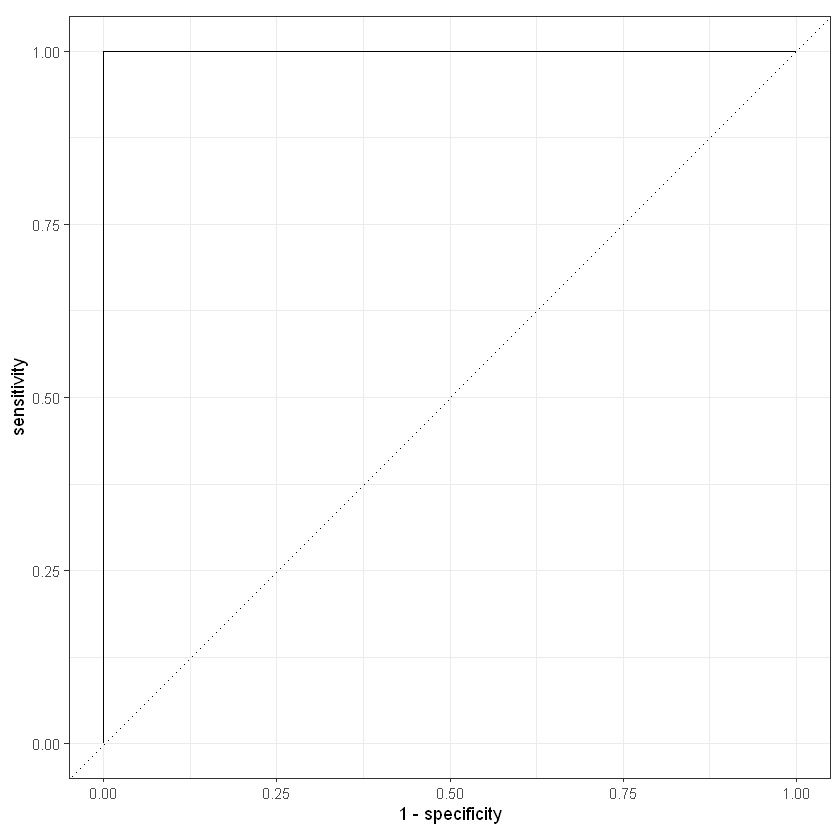

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
roc_auc,binary,0.9964426


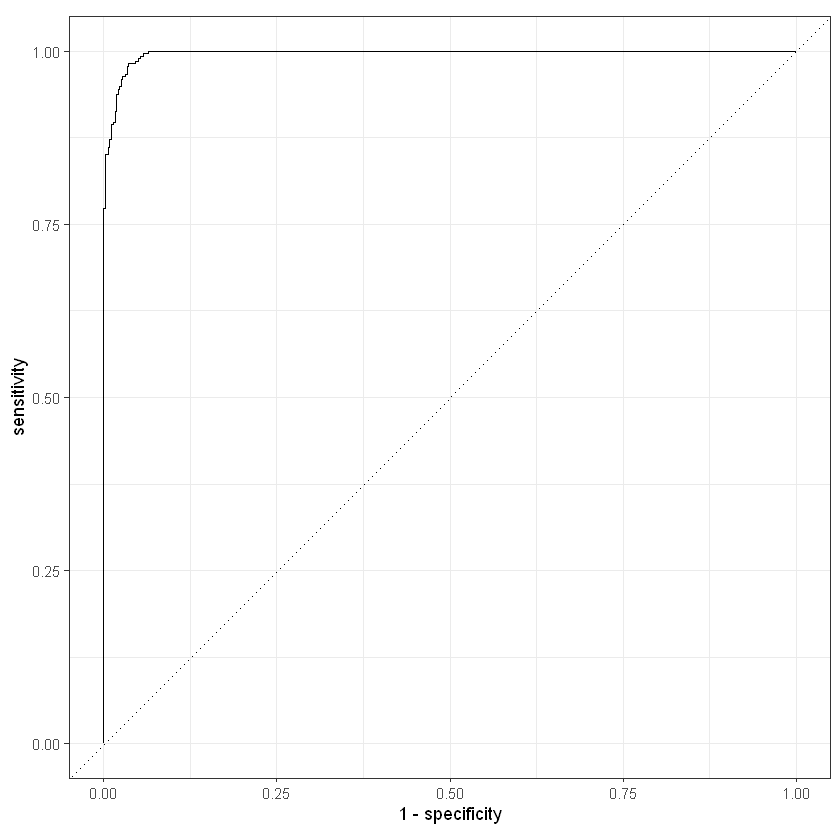

In [26]:
# logistic regression model
lr_roc_curve <- roc_curve(lr_fit_predictions, Gearbox, .pred_Automatic)
roc_curve(two_class_example, truth, Class1)
autoplot(lr_roc_curve)

lr_roc_auc <- roc_auc(lr_fit_predictions, Gearbox, .pred_Automatic)
lr_roc_auc


# random forest model
rf_roc_curve <- roc_curve(rf_fit_predictions, Gearbox, .pred_Automatic)
rf_roc_curve
autoplot(rf_roc_curve)

rf_roc_auc <- roc_auc(rf_fit_predictions, Gearbox, .pred_Automatic)
rf_roc_auc

In [27]:
set.seed(1234)
test_lr <- broom::augment (lr_fit, new_data = test_tbl)
test_rf <- broom::augment (rf_fit, new_data = test_tbl)

Warning message:
"! There are new levels in `Runned_Miles`: "16391", "52624", "62075", "16915", "1743", "19099", "34646", "149114",
  "2750", "11363", "2588", "76180", "54600", "10343", "91854", "46300", "57741", "128321", …, "35052", and "41600".
ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values."
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message in predict.lm(object, newdata, se.fit, scale = 1, type = if (type == :
"prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases"
Warning message:
"! There are new levels in `Runned_Miles`: "16391", "52624", "62075", "16915", "1743", "19099", "34646", "149114",
  "2750", "11363", "2588", "76180", "54600", "10343", "91854", "46300", "57741", "128321", …, "35052", and "41600".
ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step

In [28]:
test_lr$Gearbox <- as.factor(test_lr$Gearbox)
test_rf$Gearbox <- as.factor(test_lr$Gearbox)

conf_mat(test_lr, truth = Gearbox, estimate = `.pred_class`)
conf_mat(test_rf, truth = Gearbox, estimate = `.pred_class`)

           Truth
Prediction  Automatic Manual
  Automatic        12     21
  Manual           15     26

           Truth
Prediction  Automatic Manual
  Automatic        56     10
  Manual           36    149

In [29]:
accuracy(test_lr, truth = Gearbox, estimate = `.pred_class`)
accuracy(test_rf, truth = Gearbox, estimate = `.pred_class`)

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.5135135


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.8167331


In [30]:
f_meas(test_lr, truth = Gearbox, estimate = `.pred_class`)
f_meas(test_rf, truth = Gearbox, estimate = `.pred_class`)

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
f_meas,binary,0.4


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
f_meas,binary,0.7088608


.threshold,specificity,sensitivity
<dbl>,<dbl>,<dbl>
-Inf,0.0000000,1.0000000
2.220446e-16,0.0000000,1.0000000
3.838845e-08,0.5319149,0.4814815
4.335565e-01,0.5319149,0.4444444
8.631021e-01,0.5531915,0.4444444
1.000000e+00,0.5744681,0.4444444
Inf,1.0000000,0.0000000


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
roc_auc,binary,0.5074862


.threshold,specificity,sensitivity
<dbl>,<dbl>,<dbl>
-Inf,0.000000000,1.0000000
0.02310630,0.000000000,1.0000000
0.03151018,0.006289308,1.0000000
0.03994097,0.012578616,1.0000000
0.04248987,0.018867925,1.0000000
0.04263707,0.025157233,1.0000000
0.04272496,0.031446541,1.0000000
0.04335810,0.037735849,1.0000000
0.04410447,0.044025157,1.0000000


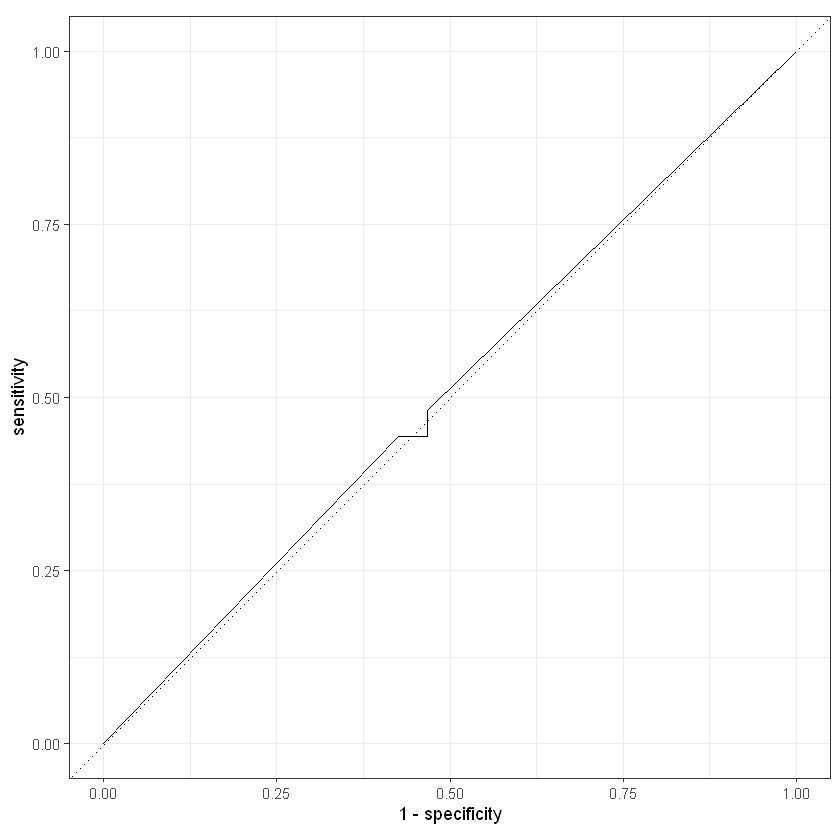

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
roc_auc,binary,0.8545939


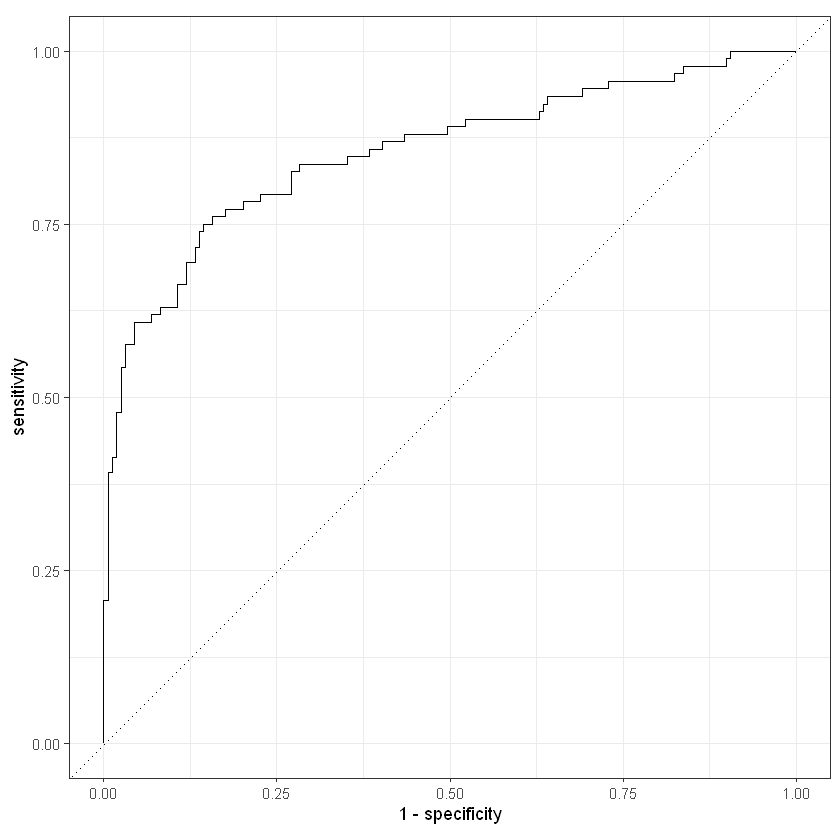

In [31]:
lr_roc_curve_test <- roc_curve(test_lr, Gearbox, .pred_Automatic)
lr_roc_curve_test
autoplot(lr_roc_curve_test)

lr_roc_auc_test <- roc_auc(test_lr, Gearbox, .pred_Automatic)
lr_roc_auc_test

# random forest model
rf_roc_curve_test <- roc_curve(test_rf, Gearbox,  .pred_Automatic)
rf_roc_curve_test
autoplot(rf_roc_curve_test)

rf_roc_auc_test <- roc_auc(test_rf, Gearbox, .pred_Automatic)
rf_roc_auc_test

In [32]:
# raw coefficients
lr_fit_coefficients2 <- tidy(extract_fit_parsnip(lr_fit))

# exponentiated coefficients
coeffs_exp <- tidy(extract_fit_parsnip(lr_fit), exponentiate = TRUE)

In [33]:
lr_fit %>%
    tidy() %>%
    mutate(term = fct_reorder(term, estimate)) %>%
    ggplot(aes(estimate, term, fill = estimate > 0)) +
    geom_col() +
    theme(legend.position = "none")

ERROR: [1m[33mError[39m in `mutate()`:[22m
[1m[22m[36mℹ[39m In argument: `term = fct_reorder(term, estimate)`.
[1mCaused by error in `lvls_reorder()`:[22m
[1m[22m[33m![39m `idx` must contain one integer for each level of `f`


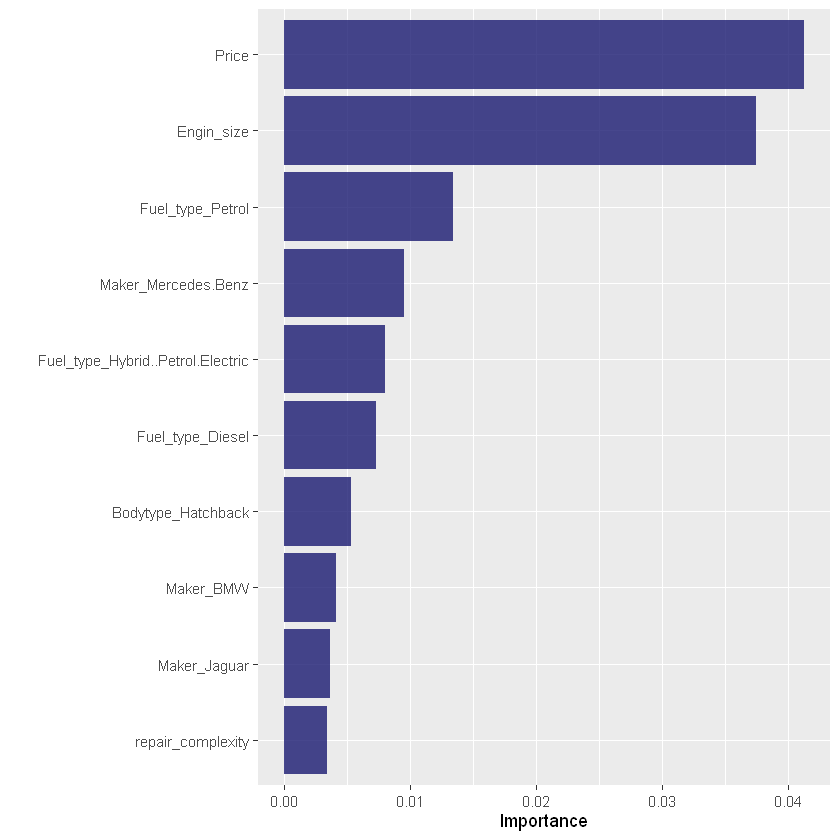

In [34]:
set.seed(1234)
rf_imp_spec <- rf_spec %>%
    set_engine("ranger", importance = "permutation")

workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_imp_spec) %>%
    fit(train_tbl) %>%
    extract_fit_parsnip() %>%
    vip(aesthetics = list(alpha = 0.8, fill = "midnightblue"))

In [35]:
set.seed(1234)
cv_train <- vfold_cv(train_tbl, v = 5, repeats = 1, strata = Gearbox)
as.data.frame(cv_train)


splits,id
<list>,<chr>


In [36]:
set.seed(1234)
lr_resamples <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lr_spec) %>%
    fit_resamples(resamples = cv_train, 
                  control = control_resamples(save_pred = TRUE))

→ A | warning: glm.fit: algorithm did not converge

There were issues with some computations   A: x1
                                                
→ B | warning: ! There are new levels in `Runned_Miles`: "79071", "9000", "49200", "17201", "36794", "23930", "108000", "76450",
                 "40664", "39134", "10791", "4678", "38626", "2997", "117000", "10222", "118310", "6678", …, "49175", and "3500".
               ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values., prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

There were issues with some computations   A: x1
There were issues with some computations   A: x1   B: x1
There were issues with some computations   A: x2   B: x1
                                                        
→ C | warning: ! There are new levels in `Runned_Miles`: "27934", "91677", "81300", "36128", "32211", "69165", "106000", "103528",
                 "3232", "3691", "12933", "

In [37]:
as.data.frame(lr_resamples)

splits,id,.metrics,.notes,.predictions
<list>,<chr>,<list>,<list>,<list>


In [38]:
set.seed(1234)
rf_resamples <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_spec) %>%
    fit_resamples(resamples = cv_train, 
                  control = control_resamples(save_pred = TRUE))


→ A | warning: ! There are new levels in `Runned_Miles`: "79071", "9000", "49200", "17201", "36794", "23930", "108000", "76450",
                 "40664", "39134", "10791", "4678", "38626", "2997", "117000", "10222", "118310", "6678", …, "49175", and "3500".
               ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values.

There were issues with some computations   A: x1
                                                
→ B | warning: ! There are new levels in `Runned_Miles`: "27934", "91677", "81300", "36128", "32211", "69165", "106000", "103528",
                 "3232", "3691", "12933", "12186", "79827", "50831", "13924", "1799", "10062", "13470", …, "151", and "49982".
               ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values.

There were issues with some computations   A: x1
There were issues with some computations   A: x1   B: x1
                                       

In [39]:
# examine the resulted tibble
as.data.frame(rf_resamples)

splits,id,.metrics,.notes,.predictions
<list>,<chr>,<list>,<list>,<list>


In [40]:
set.seed(1234)
rf_resamples <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_spec) %>%
    fit_resamples(resamples = cv_train, 
                  control = control_resamples(save_pred = TRUE))

→ A | warning: ! There are new levels in `Runned_Miles`: "79071", "9000", "49200", "17201", "36794", "23930", "108000", "76450",
                 "40664", "39134", "10791", "4678", "38626", "2997", "117000", "10222", "118310", "6678", …, "49175", and "3500".
               ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values.

There were issues with some computations   A: x1
                                                
→ B | warning: ! There are new levels in `Runned_Miles`: "27934", "91677", "81300", "36128", "32211", "69165", "106000", "103528",
                 "3232", "3691", "12933", "12186", "79827", "50831", "13924", "1799", "10062", "13470", …, "151", and "49982".
               ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values.

There were issues with some computations   A: x1
There were issues with some computations   A: x1   B: x1
                                       

In [41]:
as.data.frame(rf_resamples)

splits,id,.metrics,.notes,.predictions
<list>,<chr>,<list>,<list>,<list>


In [42]:
# performance metrics (mean) across folds for each grid line
lr_resamples %>% collect_metrics()

#  get the metrics for each resample
detailed_metrics_lr <- lr_resamples %>% collect_metrics(summarize = FALSE)
View(detailed_metrics_lr) 

.metric,.estimator,mean,n,std_err,.config
<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
accuracy,binary,0.5033041,5,0.01688144,Preprocessor1_Model1
brier_class,binary,0.4968008,5,0.01686762,Preprocessor1_Model1
roc_auc,binary,0.4993479,5,0.01909009,Preprocessor1_Model1


id,.metric,.estimator,.estimate,.config
<chr>,<chr>,<chr>,<dbl>,<chr>
Fold1,accuracy,binary,0.5106383,Preprocessor1_Model1
Fold1,roc_auc,binary,0.4981685,Preprocessor1_Model1
Fold1,brier_class,binary,0.4893617,Preprocessor1_Model1
Fold2,accuracy,binary,0.5116279,Preprocessor1_Model1
Fold2,roc_auc,binary,0.5142544,Preprocessor1_Model1
Fold2,brier_class,binary,0.4889052,Preprocessor1_Model1
Fold3,accuracy,binary,0.4745763,Preprocessor1_Model1
Fold3,roc_auc,binary,0.4473684,Preprocessor1_Model1
Fold3,brier_class,binary,0.5254237,Preprocessor1_Model1


In [43]:
# performance metrics (mean) across folds for each grid line
rf_resamples %>% collect_metrics()

#  get the metrics for each resample
detailed_metrics_rf <- rf_resamples %>% collect_metrics(summarize = FALSE)
View(detailed_metrics_rf)  

.metric,.estimator,mean,n,std_err,.config
<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
accuracy,binary,0.8210828,5,0.008066289,Preprocessor1_Model1
brier_class,binary,0.1460055,5,0.003897334,Preprocessor1_Model1
roc_auc,binary,0.8405983,5,0.014997396,Preprocessor1_Model1


id,.metric,.estimator,.estimate,.config
<chr>,<chr>,<chr>,<dbl>,<chr>
Fold1,accuracy,binary,0.8133333,Preprocessor1_Model1
Fold1,roc_auc,binary,0.8367464,Preprocessor1_Model1
Fold1,brier_class,binary,0.1492081,Preprocessor1_Model1
Fold2,accuracy,binary,0.8133333,Preprocessor1_Model1
Fold2,roc_auc,binary,0.8935885,Preprocessor1_Model1
Fold2,brier_class,binary,0.1369855,Preprocessor1_Model1
Fold3,accuracy,binary,0.8133333,Preprocessor1_Model1
Fold3,roc_auc,binary,0.8187560,Preprocessor1_Model1
Fold3,brier_class,binary,0.1556962,Preprocessor1_Model1


In [44]:
set.seed(1234)
test__lr <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lr_spec) %>%
    last_fit(splits) 

test__lr %>% collect_metrics() 

→ A | warning: glm.fit: algorithm did not converge

There were issues with some computations   A: x1
                                                
→ B | warning: ! There are new levels in `Runned_Miles`: "16391", "52624", "62075", "16915", "1743", "19099", "34646", "149114",
                 "2750", "11363", "2588", "76180", "54600", "10343", "91854", "46300", "57741", "128321", …, "35052", and "41600".
               ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values., prediction from rank-deficient fit; attr(*, "non-estim") has doubtful cases

There were issues with some computations   A: x1
There were issues with some computations   A: x1   B: x1
There were issues with some computations   A: x1   B: x1




.metric,.estimator,.estimate,.config
<chr>,<chr>,<dbl>,<chr>
accuracy,binary,0.5135135,Preprocessor1_Model1
roc_auc,binary,0.5074862,Preprocessor1_Model1
brier_class,binary,0.4855800,Preprocessor1_Model1


In [45]:
set.seed(1234)
test__rf <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_spec) %>%
    last_fit(splits) 

test__rf %>% collect_metrics() 

→ A | warning: ! There are new levels in `Runned_Miles`: "16391", "52624", "62075", "16915", "1743", "19099", "34646", "149114",
                 "2750", "11363", "2588", "76180", "54600", "10343", "91854", "46300", "57741", "128321", …, "35052", and "41600".
               ℹ Consider using step_novel() (`?recipes::step_novel()`) before `step_dummy()` to handle unseen values.

There were issues with some computations   A: x1
There were issues with some computations   A: x1




.metric,.estimator,.estimate,.config
<chr>,<chr>,<dbl>,<chr>
accuracy,binary,0.8207171,Preprocessor1_Model1
roc_auc,binary,0.8500137,Preprocessor1_Model1
brier_class,binary,0.1424043,Preprocessor1_Model1


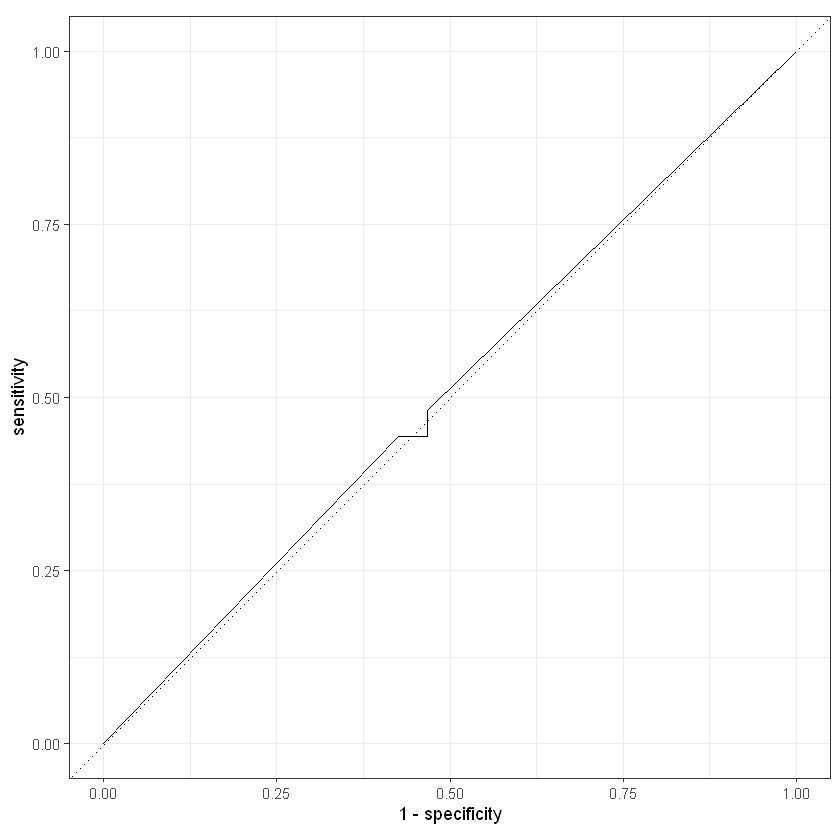

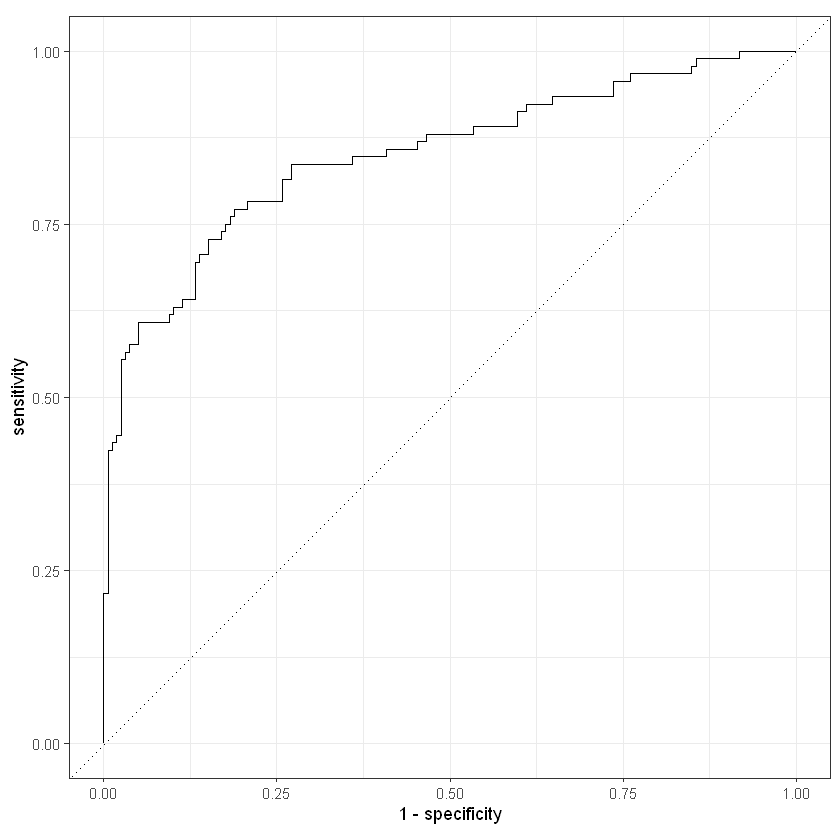

In [46]:
test__lr %>%
    unnest(`.predictions`) %>%
    roc_curve(Gearbox, .pred_Automatic) %>%
    autoplot()

test__rf %>%
    unnest(`.predictions`) %>%
    roc_curve(Gearbox, .pred_Automatic) %>%
    autoplot()

In [47]:
set.seed(1234)
lr_fit <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lr_spec) %>%
    fit(data = train_tbl)
lr_fit

coeffs <- tidy(extract_fit_parsnip(lr_fit))
coeffs

lr_fit %>%
    tidy() %>%
    mutate(term = fct_reorder(term, estimate)) %>%
    ggplot(aes(estimate, term, fill = estimate > 0)) +
    geom_col() +
    theme(legend.position = "none")


coeffs_exp <- tidy(extract_fit_parsnip(lr_fit), exponentiate = TRUE)
coeffs_exp

Warning message:
"glm.fit: algorithm did not converge"


══ Workflow [trained] ══════════════════════════════════════════════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: logistic_reg()

── Preprocessor ────────────────────────────────────────────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_impute_knn()
• step_dummy()
• step_zv()

── Model ───────────────────────────────────────────────────────────────────────────────────────────────────────────────

Call:  stats::glm(formula = ..y ~ ., family = stats::binomial, data = data)

Coefficients:
                              (Intercept)  
                                1.655e+07  
                                 Adv_year  
                               -8.402e+03  
                                Adv_month  
                               -7.285e+02  
                                 Reg_year  
                               -4.249e+00  
                               Engin_size  
                               -6.494e-01

term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),1.655428e+07,3.694095e+11,4.481281e-05,0.9999642
Adv_year,-8.401514e+03,1.874666e+08,-4.481607e-05,0.9999642
Adv_month,-7.284989e+02,1.605066e+07,-4.538748e-05,0.9999638
Reg_year,-4.249204e+00,2.821001e+05,-1.506275e-05,0.9999880
Engin_size,-6.494045e-01,1.768195e+04,-3.672696e-05,0.9999707
Price,7.028319e-03,2.058017e+02,3.415092e-05,0.9999728
Seat_num,-3.229354e+00,1.291163e+05,-2.501121e-05,0.9999800
Door_num,2.157831e+01,1.085297e+06,1.988240e-05,0.9999841
issue_id,5.053766e+01,7.516827e+05,6.723270e-05,0.9999464


ERROR: [1m[33mError[39m in `mutate()`:[22m
[1m[22m[36mℹ[39m In argument: `term = fct_reorder(term, estimate)`.
[1mCaused by error in `lvls_reorder()`:[22m
[1m[22m[33m![39m `idx` must contain one integer for each level of `f`


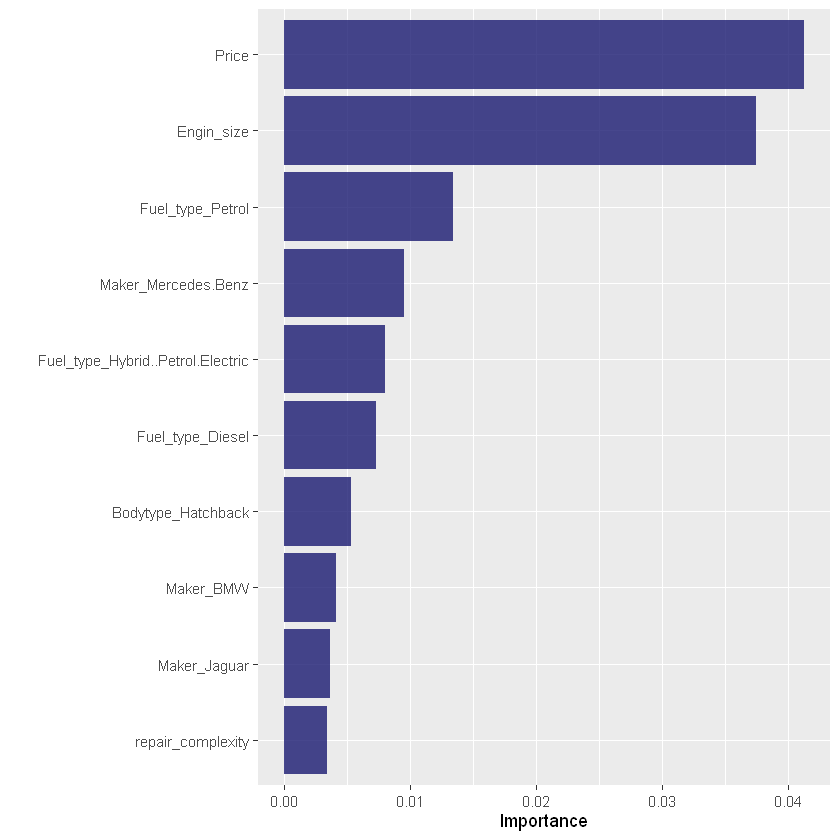

In [48]:
set.seed(1234)
rf_imp_spec <- rf_spec %>%
    set_engine("ranger", importance = "permutation")

workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_imp_spec) %>%
    fit(train_tbl) %>%
    extract_fit_parsnip() %>%
    vip(aesthetics = list(alpha = 0.8, fill = "midnightblue"))